In [1]:
import os
import sys
import glob
import matplotlib.pyplot as plt
import numpy as np
import json
from snudda.utils.load_network_simulation import SnuddaLoadNetworkSimulation

In [2]:
network_path = os.path.join("networks", "dspn_network")
network_file = os.path.join(network_path, "network-synapses.hdf5")

In [3]:
simulations = dict()

In [4]:

for g in glob.glob(os.path.join(network_path, "simulation", "vclamp.json")):

    name = os.path.basename(g).split(".")[0]
    with open(g, "r") as f:
        d = json.load(f)
    simulations.update({name : d})
   

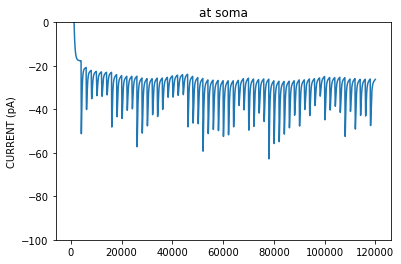

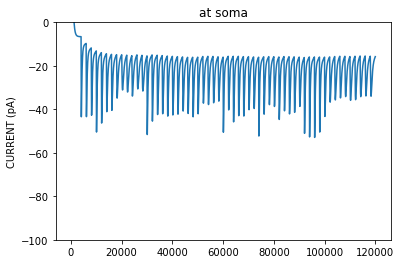

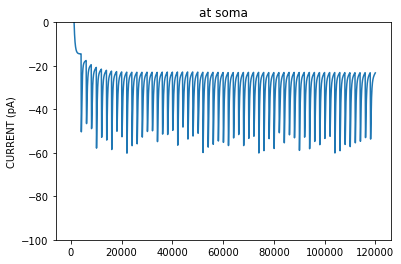

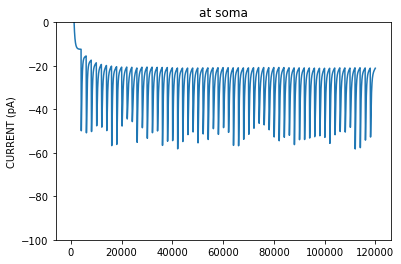

CPU times: user 398 ms, sys: 23 ms, total: 421 ms
Wall time: 424 ms


In [5]:
%%time
for r, k in enumerate(simulations.keys()):
    for cell_no in range(4):


        d = simulations[k][str(cell_no)]
        m = np.mean(np.array(d)[1200:1300]*1e3)
        plt.figure()
        plt.title("at soma")
        plt.plot(np.array(d)*1e3 - m)
        plt.ylabel("CURRENT (pA)")
        plt.ylim(-100,0)
plt.show()

/home/jofrony/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


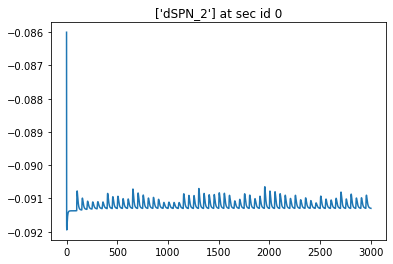

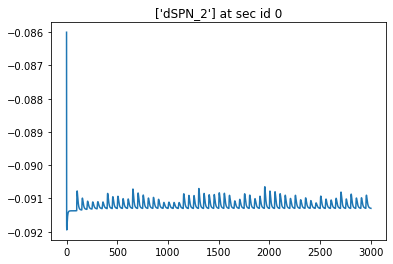

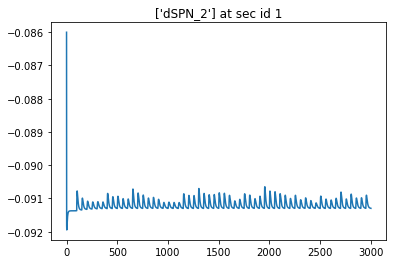

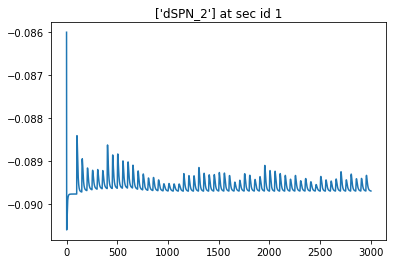

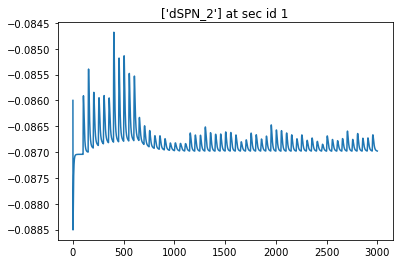

...

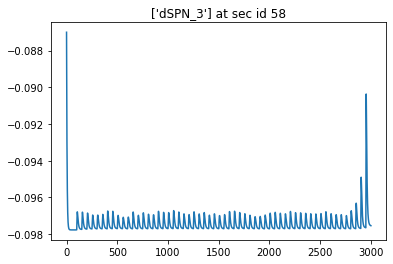

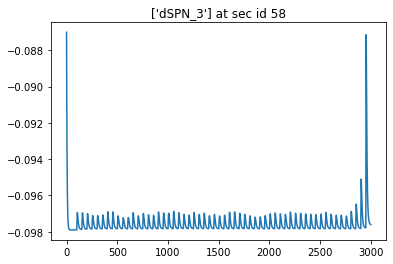

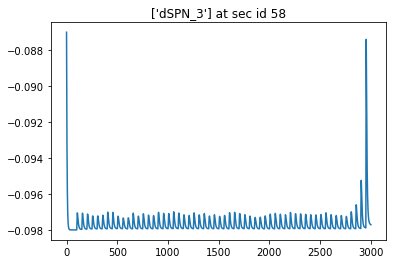

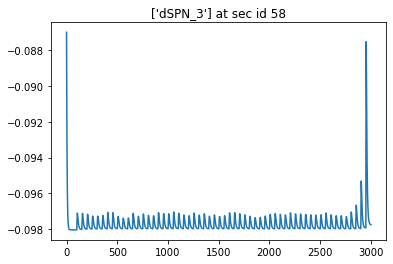

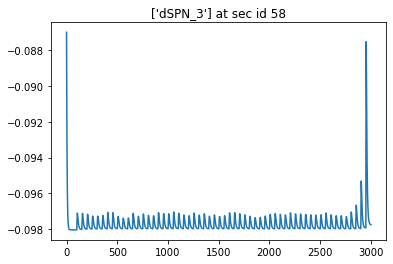

CPU times: user 2min 58s, sys: 5.55 s, total: 3min 4s
Wall time: 3min 2s


In [16]:
%%time
for cell_no in range(4):
    
    
    for r, k in enumerate(simulations.keys()):
        sns = simulations[k]
        
        vs = sns.get_voltage(cell_no).T
        sec_id = sns.network_simulation_file['neurons'][str(cell_no)]['voltage']['sec_id'][()]
        for i, v in enumerate(vs):
            plt.figure()
            plt.title(f"{sns.get_neuron_name([cell_no])} at sec id {sec_id[i]}")
            plt.plot(time*1e3,v)  
plt.show()